<h2 style='color:green'> Imports </h2>


In [1]:
! pip install tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 612.1/612.1 kB 5.4 MB/s eta 0:00:00


In [2]:
  import os
  import pathlib
  import time
  import datetime
  import imageio
  from glob import glob
  import gdown
  from zipfile import ZipFile
  from functools import partial

  import tensorflow as tf
  import tensorflow.keras.backend as K
  import tensorflow_addons as tfa
  from tensorflow import keras
  from tensorflow_addons.layers import InstanceNormalization
  from matplotlib import pyplot as plt
  import numpy as np

  from IPython import display
  from termcolor import colored
  from tqdm import tqdm
  from IPython.display import Image
  import PIL
  from PIL import ImageDraw
  from IPython import display
  from tensorflow.keras import layers



/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [10]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:

def set_seed(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    os.environ['TF_DETERMINISTIC_OPS'] = '1'
    print(f'setting seed to {seed}')


class CFG:

    # Dimension of image
    IMG_WIDTH =  512
    IMG_HEIGHT = 512

    #resize image
    resize_height = 700
    resize_width = 1200

    #the lambda param in loss
    LAMBDA = 10
    #--------train pipe-------------
    BUFFER_SIZE = 100
    # The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
    BATCH_SIZE = 2

    #cache
    cache= 50

    #learning rate
    learning_rate = 0.00025


    seed = 7


set_seed(CFG.seed)

setting seed to 7


<h2 style='color:green'> Data directories </h2>


Image dimensions (681, 1024, 3)


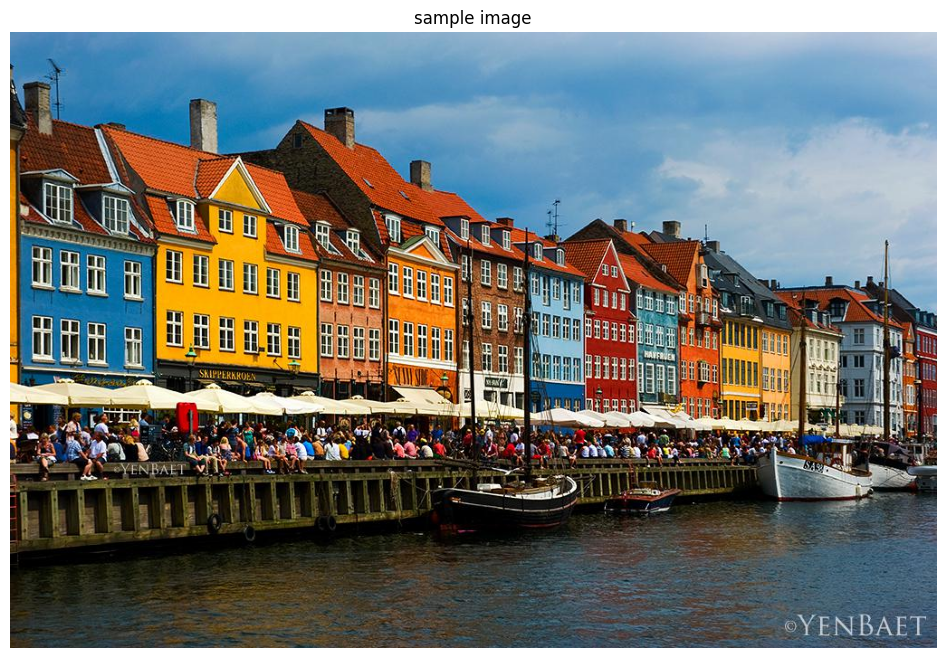

In [11]:
day_dir = '/content/drive/MyDrive/unpaired day night/day'
night_dir = '/content/drive/MyDrive/unpaired day night/night'


#plotting a sample image
plt.figure(figsize=(16,8))

img = plt.imread(day_dir + '/' + os.listdir(day_dir)[0])
plt.imshow(img)
plt.axis('off')
plt.title('sample image')
print(f'Image dimensions {img.shape}')
plt.show()

<h2 style='color:green'> building data loading pipeline </h2>


In [12]:
def load_image(image_file):
    '''load a image file'''
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)

    return image


def random_crop(image):
    '''randomly crop image into defined size '''
    cropped_image = tf.image.random_crop(image, size=[CFG.IMG_HEIGHT, CFG.IMG_WIDTH, 3])

    return cropped_image


def normalize(image):
    '''normalizing the images to [-1, 1]'''
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1
    return image


def de_normalize(image):
    '''De normalize the image to be in range (0,1)'''

    return (image * 0.5) + 0.5


In [6]:
def image_augmentations(image):
    ''' perform spatial augmentations (rotation and flips) on input image'''

    # --------------------rotations----------
    #rotation probabliity
    p_rotate = tf.random.uniform([], 0, 1.0, dtype=tf.float32)

    if p_rotate > .8:
        image = tf.image.rot90(image, k=3) # rotate 270º
    elif p_rotate > .6:
        image = tf.image.rot90(image, k=2) # rotate 180º
    elif p_rotate > .4:
        image = tf.image.rot90(image, k=1) # rotate 90º



    # ----------------------Flips---------------------
    p_flip = tf.random.uniform([], 0, 1.0, dtype=tf.float32)

    if p_flip > 0.7:
        image = tf.image.random_flip_left_right(image)
    elif p_flip < 0.3:
        image = tf.image.random_flip_up_down(image)

    return image

In [7]:
def random_jitter(image):
    '''resize and randommly crop the input image'''

#     # resizing image
    image = tf.image.resize(image, size=(CFG.resize_height, CFG.resize_width),
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    # randomly cropping to 512,512
    image = random_crop(image)

    return image


def preprocess_image_train(image):
    image = load_image(image)
    image = random_jitter(image)
    image= image_augmentations(image)
    image = normalize(image)
    return image


#same function, withou the augemntation
def preprocess_image_eval(image):
    image = load_image(image)
    image = random_jitter(image)
    image = normalize(image)
    return image



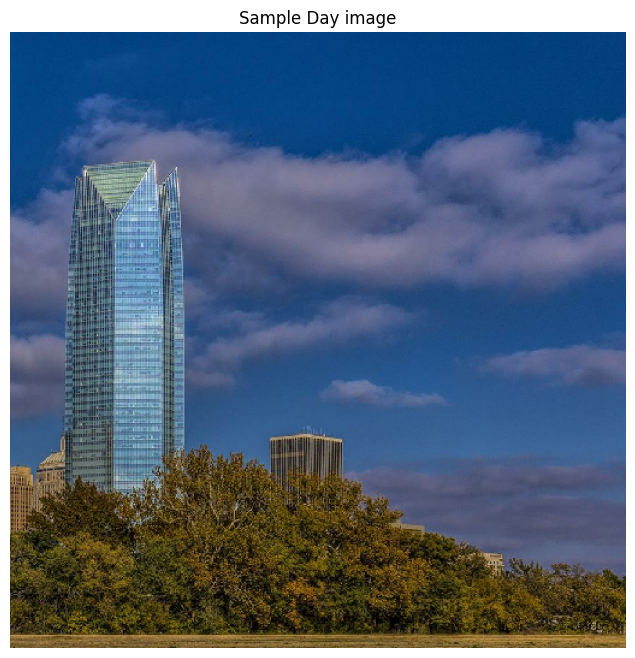

In [13]:


def create_img_dataset(directory,
                       image_preprocess_fn,
                       image_extension = 'jpg',
                       repeat=True
                      ):
    '''create a tf dataset object from a directory of images'''
    img_list = glob(directory+f'/*{image_extension}')

    dataset = tf.data.Dataset.list_files(img_list)

    dataset = dataset.map(image_preprocess_fn,
                          num_parallel_calls=tf.data.AUTOTUNE)

    if repeat :
        dataset = dataset.repeat()

    dataset = dataset.shuffle(CFG.BUFFER_SIZE)
    dataset = dataset.batch(CFG.BATCH_SIZE)
    return dataset


Day_Dataset = create_img_dataset(directory = day_dir,image_preprocess_fn = preprocess_image_train)

#without augmentation
Day_eval = create_img_dataset(directory = day_dir,
                            image_preprocess_fn = preprocess_image_eval)



fig,ax = plt.subplots(figsize=(16,8))

inp_img = next(iter(Day_Dataset))
plt.imshow(de_normalize(inp_img[0]))
plt.title('Sample Day image')
plt.axis('off')

plt.show()

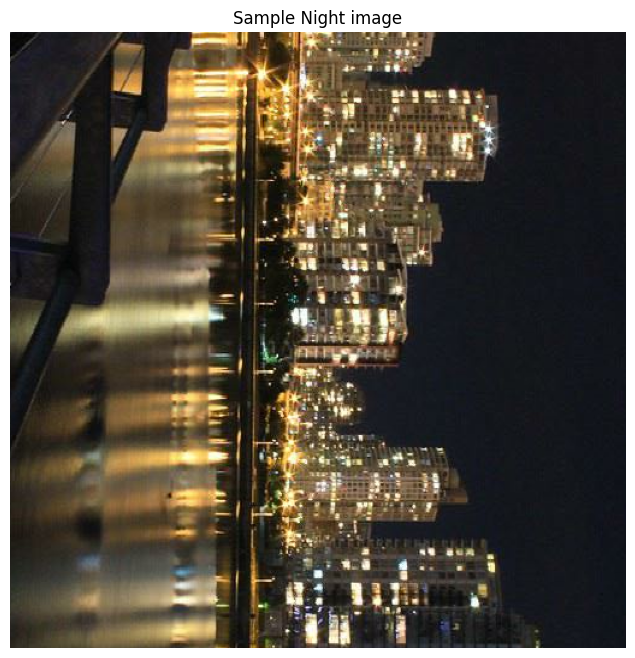

In [14]:
Night_Dataset = create_img_dataset(directory = night_dir,image_preprocess_fn = preprocess_image_train)
Night_eval = create_img_dataset(directory = night_dir,
                                image_preprocess_fn = preprocess_image_eval)
fig,ax = plt.subplots(figsize=(16,8))


inp_img = next(iter(Night_Dataset))
plt.imshow(de_normalize(inp_img[0]))
plt.title('Sample Night image')
plt.axis('off')

plt.show()


In [15]:
# train data set

Train_Dataset = tf.data.Dataset.zip((Day_Dataset,Night_Dataset))

<h2 style='color:green'> Building Model</h2>


**Upsampling and downsampling blocks**

In [16]:

#conv weights initilaizer
conv_initializer = tf.random_normal_initializer(mean=0.0,
                                                stddev=0.02)

#init for intance normalization
gamma_initializer = tf.keras.initializers.RandomNormal(mean=0.0,
                                                       stddev=0.02)




def downsample(input_layer,
               filters,
               name,
               size=3,
               strides=2,
               activation=tf.keras.layers.ReLU(),
               ):

    '''perform a downsampling by applying a convolution,followed by instance norm and activation'''
    conv = tf.keras.layers.Conv2D(filters,
                                  size,
                                  strides=strides,
                                  padding='same',
                                  use_bias=False,
                                  kernel_initializer=conv_initializer,
                                  name=f'encoder_{name}')(input_layer)


    conv = tfa.layers.InstanceNormalization(axis=-1,gamma_initializer=gamma_initializer)(conv)

    conv = activation(conv)

    return conv


def upsample(input_layer,
             filters,
             name,
             size=3,
             strides=2,
             activation='relu'):

    res = tf.keras.layers.Conv2DTranspose(filters, size,
                                          strides=strides,
                                          padding='same',
                                          use_bias=False,
                                          kernel_initializer=conv_initializer,
                                          name=f'decoder_{name}')(input_layer)

    res = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(res)

    res =  tf.keras.layers.Activation(activation)(res)

    return res

**Residual block**

In [17]:

def residual_block(input_layer,
                   size=3,
                   strides=1,
                   name='block_x'):
    '''performs 2 convolutions followed by an added skip connection with the input'''


    filters = input_layer.shape[-1]
    block = tf.keras.layers.Conv2D(filters,
                     size,
                     strides=strides,
                     padding='same',
                     use_bias=False,
                     kernel_initializer=conv_initializer,
                     name=f'residual_{name}')(input_layer)

    block = tf.keras.layers.Activation('relu')(block)
    block = tf.keras.layers.Conv2D(filters, size, strides=strides, padding='same', use_bias=False,
                     kernel_initializer=conv_initializer, name=f'transformer_{name}_2')(block)

    #skip connection
    res = tf.keras.layers.Add()([block, input_layer])

    return res


def concat_layer(layer_1,layer_2,name):
    '''concatenation of layers for skip connections'''
    return tf.keras.layers.Concatenate(name=name)([layer_1,layer_2])


<h3 style='color:lightgreen'> Building Generator</h3>


In [18]:
def fade_in(alpha, a, b):
    return alpha * a + (1.0 - alpha) * b


def wasserstein_loss(y_true, y_pred):
    return -tf.reduce_mean(y_true * y_pred)


def pixel_norm(x, epsilon=1e-8):
    return x / tf.math.sqrt(tf.reduce_mean(x ** 2, axis=-1, keepdims=True) + epsilon)


def minibatch_std(input_tensor, epsilon=1e-8):
    n, h, w, c = tf.shape(input_tensor)
    group_size = tf.minimum(4, n)
    x = tf.reshape(input_tensor, [group_size, -1, h, w, c])
    group_mean, group_var = tf.nn.moments(x, axes=(0), keepdims=False)
    group_std = tf.sqrt(group_var + epsilon)
    avg_std = tf.reduce_mean(group_std, axis=[1, 2, 3], keepdims=True)
    x = tf.tile(avg_std, [group_size, h, w, 1])
    return tf.concat([input_tensor, x], axis=-1)


class EqualizedConv(layers.Layer):
    def __init__(self, out_channels, kernel=3, gain=2, **kwargs):
        super().__init__(**kwargs)
        self.kernel = kernel
        self.out_channels = out_channels
        self.gain = gain
        self.pad = kernel != 1

    def build(self, input_shape):
        self.in_channels = input_shape[-1]
        initializer = keras.initializers.RandomNormal(mean=0.0, stddev=1.0)
        self.w = self.add_weight(
            shape=[self.kernel, self.kernel, self.in_channels, self.out_channels],
            initializer=initializer,
            trainable=True,
            name="kernel",
        )
        self.b = self.add_weight(
            shape=(self.out_channels,), initializer="zeros", trainable=True, name="bias"
        )
        fan_in = self.kernel * self.kernel * self.in_channels
        self.scale = tf.sqrt(self.gain / fan_in)

    def call(self, inputs):
        if self.pad:
            x = tf.pad(inputs, [[0, 0], [1, 1], [1, 1], [0, 0]], mode="REFLECT")
        else:
            x = inputs
        output = (
            tf.nn.conv2d(x, self.scale * self.w, strides=1, padding="VALID") + self.b
        )
        return output


class EqualizedDense(layers.Layer):
    def __init__(self, units, gain=2, learning_rate_multiplier=1, **kwargs):
        super().__init__(**kwargs)
        self.units = units
        self.gain = gain
        self.learning_rate_multiplier = learning_rate_multiplier

    def build(self, input_shape):
        self.in_channels = input_shape[-1]
        initializer = keras.initializers.RandomNormal(
            mean=0.0, stddev=1.0 / self.learning_rate_multiplier
        )
        self.w = self.add_weight(
            shape=[self.in_channels, self.units],
            initializer=initializer,
            trainable=True,
            name="kernel",
        )
        self.b = self.add_weight(
            shape=(self.units,), initializer="zeros", trainable=True, name="bias"
        )
        fan_in = self.in_channels
        self.scale = tf.sqrt(self.gain / fan_in)

    def call(self, inputs):
        output = tf.add(tf.matmul(inputs, self.scale * self.w), self.b)
        return output * self.learning_rate_multiplier


class AddNoise(layers.Layer):
    def build(self, input_shape):

      n, h, w, c = input_shape[0]
      initializer = keras.initializers.RandomNormal(mean=0.0, stddev=1.0)
      self.b = self.add_weight(
          shape=[1, 1, 1, c], initializer=initializer, trainable=True, name="kernel"
      )

    def call(self, inputs):
      x, noise = inputs
      output = x + self.b * noise
      return output


class AdaIN(layers.Layer):
    def __init__(self, gain=1, **kwargs):
      super().__init__(**kwargs)
      self.gain = gain

    def build(self, input_shapes):
      x_shape = input_shapes[0]
      w_shape = input_shapes[1]

      self.w_channels = w_shape[-1]
      self.x_channels = x_shape[-1]

      self.dense_1 = EqualizedDense(self.x_channels, gain=1)
      self.dense_2 = EqualizedDense(self.x_channels, gain=1)

    def call(self, inputs):
      x, w = inputs
      ys = tf.reshape(self.dense_1(w), (-1, 1, 1, self.x_channels))
      yb = tf.reshape(self.dense_2(w), (-1, 1, 1, self.x_channels))
      return ys * x + yb




In [19]:
conv_initializer = tf.random_normal_initializer(mean=0.0,stddev=0.02)

def down_mapping(input_shape=(512,512,3)):
  inp=layers.Input(shape=input_shape)
  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(inp) #(512,512,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(256,256,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(128,128,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(64,64,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(32,32,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(16,16,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=256,kernel_size=3,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(8,8,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=512,kernel_size=2,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(4,4,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)

  x=layers.Conv2D(filters=512,kernel_size=2,strides=2,padding='same',kernel_initializer=conv_initializer)(x) #(2,2,256)
  x = tfa.layers.InstanceNormalization(gamma_initializer=conv_initializer)(x)
  x = tf.keras.layers.Activation('LeakyReLU')(x)
  x = tf.keras.layers.Flatten()(x)

  x = pixel_norm(x)
  for i in range(8):
      x = EqualizedDense(512, learning_rate_multiplier=0.01)(x)
      x = layers.LeakyReLU(0.2)(x)
  return keras.Model(inp, x)


In [22]:
night2day_gen_downmap=down_mapping()
day2night_gen_downmap=down_mapping()

In [23]:
filter_nums = {
            0: 512,
            1: 512,
            2: 512,  # 4x4
            3: 512,  # 8x8
            4: 512,  # 16x16
            5: 512,  # 32x32
            6: 256,  # 64x64
            7: 128,  # 128x128
            8: 64,  # 256x256
            9: 32,  # 512x512
            10: 16,
        }  # 1024x1024

def style_gen():

  noise = []
  noise_shapes = [(4, 4, 1), (8, 8, 1), (16, 16, 1), (32, 32, 1), (64, 64, 1), (128, 128, 1), (256, 256, 1), (512, 512, 1)]
  for shape in noise_shapes:
      noise_input = layers.Input(shape=shape)
      noise.append(noise_input)


  #block 1 -- 4x4
  #constant random noise input
  const_inp = layers.Input(shape=(4,4,512))

  # style code input
  style_code=layers.Input(shape=512)

  x = AddNoise()([const_inp, noise[0]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[0]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

  #block 2 -- 8x8
  x = layers.UpSampling2D((2, 2),name='1',interpolation='bilinear')(x)
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[1]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[1]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])


  # block 3 -- 16x16
  x = layers.UpSampling2D((2, 2),name='2',interpolation='bilinear')(x)
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[2]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[2]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

  # block 4 -- 32x32
  x = layers.UpSampling2D((2, 2),name='3',interpolation='bilinear')(x)
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[3]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(512, 3)(x)
  x = AddNoise()([x, noise[3]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

  # block 5 -- 64x64
  x = layers.UpSampling2D((2, 2),name='4',interpolation='bilinear')(x)
  x = EqualizedConv(256, 3)(x)
  x = AddNoise()([x, noise[4]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(256, 3)(x)
  x = AddNoise()([x, noise[4]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

# block 6 -- 128x128
  x = layers.UpSampling2D((2, 2),name='5',interpolation='bilinear')(x)
  x = EqualizedConv(64, 3)(x)
  x = AddNoise()([x, noise[5]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(64, 3)(x)
  x = AddNoise()([x, noise[5]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

# block 7 -- 256x256
  x = layers.UpSampling2D((2, 2),name='6',interpolation='bilinear')(x)
  x = EqualizedConv(32, 3)(x)
  x = AddNoise()([x, noise[6]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(32, 3)(x)
  x = AddNoise()([x, noise[6]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])

  # block 8 -- 512x512
  x = layers.UpSampling2D((2, 2),name='7',interpolation='bilinear')(x)
  x = EqualizedConv(32, 3)(x)
  x = AddNoise()([x, noise[7]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
  x = EqualizedConv(32, 3)(x)
  x = AddNoise()([x, noise[7]])
  x = layers.LeakyReLU(0.2)(x)
  x = InstanceNormalization()(x)
  x = AdaIN()([x, style_code])
 #  512x512x3
  x = EqualizedConv(3, 1, gain=1)(x)
  model_inputs = [const_inp, style_code] + noise
  return keras.Model(inputs=model_inputs,outputs=x)



In [24]:
night2day_gen=style_gen()
day2night_gen=style_gen()

In [25]:
day2night_gen.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_21 (InputLayer)       [(None, 4, 4, 512)]          0         []                            
                                                                                                  
 input_13 (InputLayer)       [(None, 4, 4, 1)]            0         []                            
                                                                                                  
 add_noise_16 (AddNoise)     (None, 4, 4, 512)            512       ['input_21[0][0]',            
                                                                     'input_13[0][0]']            
                                                                                                  
 leaky_re_lu_52 (LeakyReLU)  (None, 4, 4, 512)            0         ['add_noise_16[0][0]']  

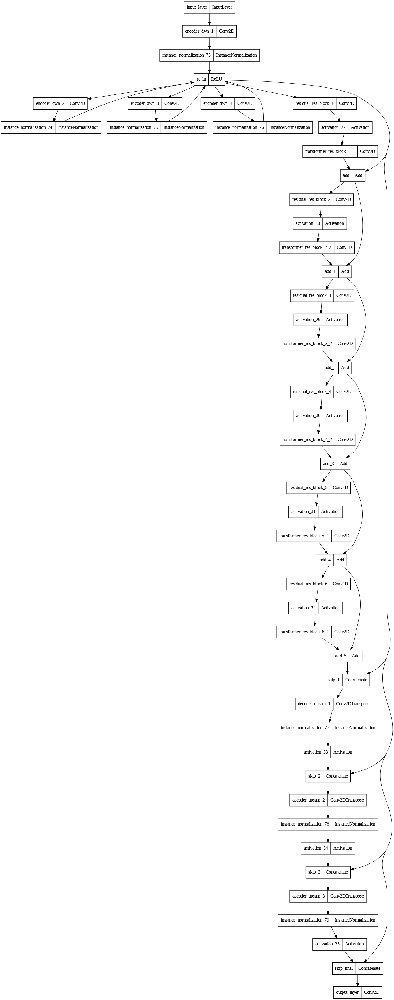

In [39]:
#plot model
tf.keras.utils.plot_model(day2night_gen,dpi=80,show_shapes=False)

<h3 style='color:green'> Building Discriminator</h3>


In [20]:

def PATCH_discriminator(leak_rate = 0.2):
    '''PATCH discriminator network'''
    leaky_relu = tf.keras.layers.LeakyReLU(leak_rate)


    input_ = tf.keras.layers.Input(shape=(CFG.IMG_WIDTH,CFG.IMG_HEIGHT,3),
                               name='input_layer')
    # Encoder
    # Input image 512,512
    x = downsample(input_layer = input_, filters=64,  strides =  2, size=4, name='dwn_1',activation = leaky_relu)    #h,w =256
    x = downsample(input_layer = x, filters=128,  strides =  2, size=4, name='dwn_2',activation = leaky_relu)        #h,w =128
    x = downsample(input_layer = x, filters=256,  strides =  2, size=4, name='dwn_3',activation = leaky_relu)        #h,w = 64
    x = downsample(input_layer = x, filters=512,  strides =  2, size=4, name='dwn_4',activation = leaky_relu)        #h,w = 32
    x = downsample(input_layer = x, filters=512,  strides =  1, size=4, name='dwn_5',activation = leaky_relu)        #h,w = 32


    output = tf.keras.layers.Conv2D(1, 4, strides=1, padding='valid', kernel_initializer=conv_initializer)(x)         #(29, 29, 1)

    return tf.keras.models.Model(inputs=input_,outputs=output)



#create instance of discriminators
day2night_disc = PATCH_discriminator()  # identify night images
night2day_disc = PATCH_discriminator()  # identify day images


/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


In [ ]:
night2day_disc.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_layer (InputLayer)       [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 encoder_dwn_1 (Conv2D)         (None, 256, 256, 64  3072        ['input_layer[0][0]']            
                                )                                                                 
                                                                                                  
 instance_normalization_55 (Ins  (None, 256, 256, 64  128        ['encoder_dwn_1[0][0]']          
 tanceNormalization)            )                                                           

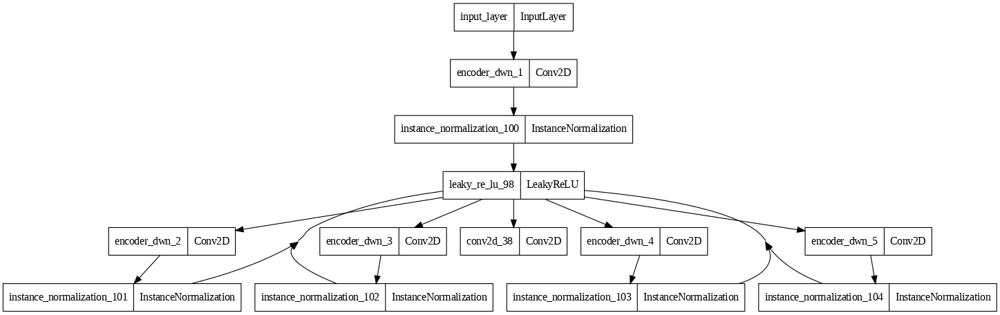

In [38]:
#plot model
tf.keras.utils.plot_model(night2day_disc,dpi=80,show_shapes=False)

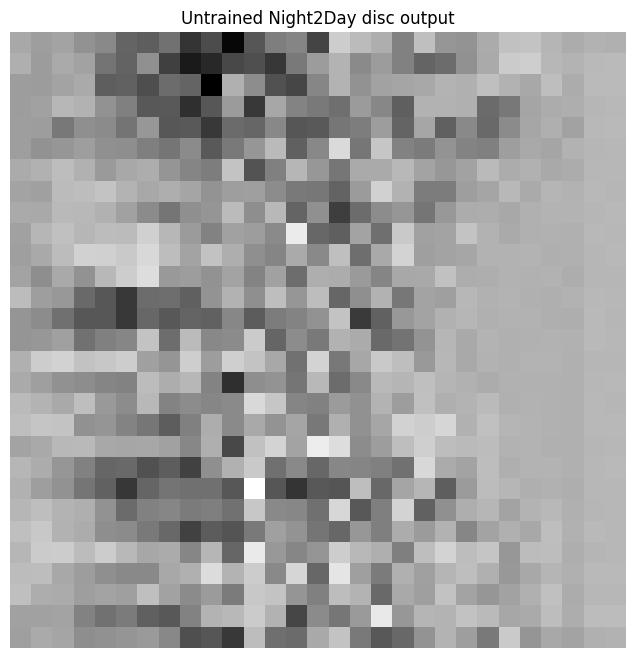

In [ ]:
#check on dicriminator

disc_output = day2night_disc(tf.expand_dims(inp_img[0],axis=0), training=False)
plt.subplots(1,1,figsize=(8,8))

plt.imshow(disc_output.numpy().mean(axis=0),cmap='gray')
plt.title('Untrained Night2Day disc output')
plt.axis('off')

plt.show()

In [ ]:
def generate_cycle(gen_1,gen_2,gen1_style_code,gen2_style_code,const_inp,noise):
    '''generate a full cycle of images using given generators'''
    gen_img_1 = gen_1([const_inp,gen1_style_code]+noise,training=True)
    gen_img_2 = gen_2([const_inp,gen2_style_code]+noise,training=True)

    return gen_img_1,gen_img_2


def calc_and_apply_gradients(tape,
                             model,
                             loss,
                             optimizer):
    '''Apply gradients for a given model using given optimizer'''
    if len(model) ==2:
      trainable_weights=(model[0].trainable_weights + model[1].trainable_weights)
    else:
      trainable_weights=model[0].trainable_weights
    #calculate gradients of loss function
    gradients = tape.gradient(loss,trainable_weights)

    #apply gradients
    optimizer.apply_gradients(zip(gradients,trainable_weights))
    return

<h3 style='color:green' >losses </h3>

In [ ]:
def discriminator_loss(real, generated):
    '''discriminator Binary CrossEntropy loss'''
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(real), real)

    generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(generated), generated)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss * 0.5

# Generator Adverserial loss
def generator_loss(generated):
    '''adverserial generator loss (BCE)'''
    return tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(generated), generated)


# Cycle consistency loss

def calc_cycle_loss(real_image, cycled_image, LAMBDA):
    '''pixel wise cycle loss between original image and cycled image'''
    mae_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))

    return LAMBDA * mae_loss


# identity loss
def identity_loss(real_image, same_image, LAMBDA):
    mae_loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return LAMBDA * 0.5 * mae_loss

<h2 style='color:green'>Cycle GAN</h2>


In [ ]:
print(glob(os.path.join('/content/drive/MyDrive/I2I model Save Point', "*.h5")))
a=glob(os.path.join('/content/drive/MyDrive/I2I model Save Point', "*.h5"))[0]
a.split('_')[-1].split('.')[0]

['/content/drive/MyDrive/I2I model Save Point/gen_d2n_weights_epoch_104.h5', '/content/drive/MyDrive/I2I model Save Point/gen_n2d_weights_epoch_104.h5', '/content/drive/MyDrive/I2I model Save Point/disc_d2n_weights_epoch_104.h5', '/content/drive/MyDrive/I2I model Save Point/disc_n2d_weights_epoch_104.h5', '/content/drive/MyDrive/I2I model Save Point/day2night_gen_downmap_weights_epoch_104.h5', '/content/drive/MyDrive/I2I model Save Point/night2day_gen_downmap_weights_epoch_104.h5']


'104'

In [ ]:
# loading model weights
day2night_gen.load_weights('/content/drive/MyDrive/I2I model Save Point/gen_d2n_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_gen.load_weights('/content/drive/MyDrive/I2I model Save Point/gen_n2d_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
day2night_disc.load_weights('/content/drive/MyDrive/I2I model Save Point/disc_d2n_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_disc.load_weights('/content/drive/MyDrive/I2I model Save Point/disc_n2d_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
day2night_gen_downmap.load_weights('/content/drive/MyDrive/I2I model Save Point/day2night_gen_downmap_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))
night2day_gen_downmap.load_weights('/content/drive/MyDrive/I2I model Save Point/night2day_gen_downmap_weights_epoch_{}.h5'.format(a.split('_')[-1].split('.')[0]))

In [ ]:
class CycleGAN(tf.keras.models.Model):
    def __init__(self,
                 lambda_cycle=10):
        super(CycleGAN, self).__init__()
        self.gen_d2n_downsample=day2night_gen_downmap
        self.gen_d2n = day2night_gen # Day -> Night
        self.gen_n2d_downsample=night2day_gen_downmap
        self.gen_n2d = night2day_gen # Night -> Day
        self.disc_d2n = day2night_disc # Classifies Night Images
        self.disc_n2d = night2day_disc # Classifier Day Images
        self.lambda_cycle = lambda_cycle #lambda in cycle consistancy loss



    def compile(self,
                gen_loss_fn,
                disc_loss_fn,
                cycle_loss_fn,
                identity_loss_fn,
                common_opt = tf.keras.optimizers.legacy.Adam(learning_rate = 0.001,beta_1 = 0.0,beta_2=0.99,epsilon=1e-08)):

        super(CycleGAN, self).compile()

        # -------optimizers ---------
        self.opt_gen_d2n = common_opt
        self.opt_gen_n2d = common_opt
        self.opt_disc_d2n = common_opt
        self.opt_disc_n2d = common_opt


        # -------losses ---------
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

    def gen_noise(self):
      noise=[]
      for i in range(2,10):
        noise.append(tf.random.normal((1,2**i,2**i,1)))
      return noise

    def train_step(self, batch_data):
        day_image, night_image = batch_data
        const_inp=tf.ones((1,4,4,512))
        noise = self.gen_noise()

        with tf.GradientTape(persistent=True) as tape:

            #-----day->night->day
            day_img_stylecode=self.gen_d2n_downsample(day_image)
            night_img_stylecode=self.gen_n2d_downsample(night_image)

            fake_night,cycled_day = generate_cycle(self.gen_d2n,
                            self.gen_n2d,  day_img_stylecode,night_img_stylecode, const_inp,
                            noise)

            # --------night -> day- > night
            fake_day,cycled_night = generate_cycle(self.gen_n2d,
                            self.gen_d2n, night_img_stylecode,day_img_stylecode,const_inp,
                                                   noise)


            #---------- generating itself (for identity loss)
            iden_day = self.gen_d2n([const_inp,night_img_stylecode] + noise, training=True)
            iden_night = self.gen_n2d([const_inp,day_img_stylecode] + noise , training=True)

            # -----------discriminator on real images
            disc_night = self.disc_d2n(night_image, training=True)
            disc_day = self.disc_n2d(day_image, training=True)

            # -----------discriminator on fake images-----------------
            disc_fake_night   = self.disc_d2n(fake_night, training=True)
            disc_fake_day = self.disc_n2d(fake_day, training=True)

            # -------------------------generator loss-------------
               #---1)adverserial loss
            night_gen_loss = self.gen_loss_fn(disc_fake_night)
            day_gen_loss = self.gen_loss_fn(disc_fake_day)

                #---2)Cycle loss loss
            total_cycle_loss = self.cycle_loss_fn(night_image, cycled_night, self.lambda_cycle) + self.cycle_loss_fn(day_image, cycled_day, self.lambda_cycle)

                # +++++3) Total Gen loss (day gen and night gen)
            total_gen_d2n_loss = night_gen_loss + total_cycle_loss + self.identity_loss_fn(night_image, iden_night,self.lambda_cycle)
            total_gen_n2d_loss = day_gen_loss + total_cycle_loss + self.identity_loss_fn(day_image, iden_day, self.lambda_cycle)


            # -------------------------Discriminator loss-------------
            night_disc_loss = self.disc_loss_fn(disc_night, disc_fake_night)  # check classifying generated and real night
            day_disc_loss = self.disc_loss_fn(disc_day, disc_fake_day)        # check  classifying generated and real day

        ## ------------------------- Calculating and Updating gradients------------------

        # day->night gen gradeints
        _ = calc_and_apply_gradients(tape=tape,
                                     model= [self.gen_d2n,self.gen_d2n_downsample],
                                     loss = total_gen_d2n_loss,
                                     optimizer = self.opt_gen_d2n)

        # night - >day  gen gradeints
        _ = calc_and_apply_gradients(tape=tape,
                                     model= [self.gen_n2d,self.gen_n2d_downsample],
                                     loss = total_gen_n2d_loss,
                                     optimizer = self.opt_gen_n2d)

        #  discrim gradients (classifies night images)
        _ = calc_and_apply_gradients(tape=tape,
                                     model= [self.disc_d2n],
                                     loss = night_disc_loss,
                                     optimizer = self.opt_disc_d2n)

        # Day discrim gradients (classifies day images)
        _ = calc_and_apply_gradients(tape=tape,
                                     model= [self.disc_n2d],
                                     loss = day_disc_loss,
                                     optimizer = self.opt_disc_n2d)


        return {'gen_D2N_loss': total_gen_d2n_loss,
                'gen_N2D_loss': total_gen_n2d_loss,
                'disc_day_loss': day_disc_loss,
                'disc_night_loss': night_disc_loss
               }




In [ ]:
 #creat a instance of Cycle gan
gan = CycleGAN()


#complie with the losses
gan.compile(gen_loss_fn=generator_loss,
            disc_loss_fn=discriminator_loss,
            cycle_loss_fn=calc_cycle_loss,
            identity_loss_fn=identity_loss)

<h3 style='color:green'>Callbacks</h3>

In [ ]:
# Callback
class GANMonitor(tf.keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self,
                 num_img=1,
                 day_paths='/content/drive/MyDrive/I2I Model Image Save Point/day',
                 night_paths='/content/drive/MyDrive/I2I Model Image Save Point/night'
                 ):
        self.num_img = num_img
        self.day_paths = day_paths
        self.night_paths = night_paths
        self.model_save_path = '/content/drive/MyDrive/I2I model Save Point'

        # dir to save genereated day images
        if not os.path.exists(self.day_paths):
            os.makedirs(self.day_paths)


        # dir to save genereated night images
        if not os.path.exists(self.night_paths):
            os.makedirs(self.night_paths)



    def on_epoch_end(self, epoch, logs=None):
      if epoch%3==0:
        #deleteing previously saved models
        files = glob(os.path.join(self.model_save_path, "*.h5"))
        for f in files:
            os.remove(f)


        #save generator models
        self.model.gen_d2n.save_weights(os.path.join(self.model_save_path,
                                      'gen_d2n_weights_epoch_{}.h5'.format(epoch+1)))
        self.model.gen_n2d.save_weights(os.path.join(self.model_save_path,
                                      'gen_n2d_weights_epoch_{}.h5'.format(epoch+1)))

        # Save the discriminator models
        self.model.disc_d2n.save_weights(os.path.join(self.model_save_path,
                                      'disc_d2n_weights_epoch_{}.h5'.format(epoch+1)))
        self.model.disc_n2d.save_weights(os.path.join(self.model_save_path,
                                      'disc_n2d_weights_epoch_{}.h5'.format(epoch+1)))

        # Save the down_Mapping models
        self.model.gen_d2n_downsample.save_weights(os.path.join(self.model_save_path,
                                      'day2night_gen_downmap_weights_epoch_{}.h5'.format(epoch+1)))
        self.model.gen_n2d_downsample.save_weights(os.path.join(self.model_save_path,
                                      'night2day_gen_downmap_weights_epoch_{}.h5'.format(epoch+1)))


        const_inp=tf.ones((1,4,4,512))
        noise=[tf.random.normal((1,2**i,2**i,1)) for i in range(2,10)]

          #generated night
        for i, img in enumerate(Day_eval.take(self.num_img)):
            style_code = day2night_gen_downmap(img)
            prediction = day2night_gen([const_inp,style_code] + noise, training=False)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            prediction = PIL.Image.fromarray(prediction)
            prediction.save(f'{self.night_paths}/generated_{i}_{epoch+1}.png')

        # generated day images
        for i, img in enumerate(Night_eval.take(self.num_img)):
            style_code = night2day_gen_downmap(img)
            prediction = night2day_gen([const_inp,style_code] + noise, training=False)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            prediction = PIL.Image.fromarray(prediction)
            prediction.save(f'{self.day_paths}/generated_{i}_{epoch+1}.png')

<h2 style='color:green'>Fitting the model</h2>


In [ ]:
#152 epochs ended with lr = 2

In [ ]:
EPOCHS = 200
csv_logger=tf.keras.callbacks.CSVLogger(
    '/content/drive/MyDrive/I2I Log Save Point/log2.csv', separator=',', append=True
)
callbacks = [GANMonitor(),csv_logger]
steps_per_epoch = 200


history = gan.fit(Train_Dataset,
                epochs = EPOCHS,
                steps_per_epoch=steps_per_epoch,
                callbacks = callbacks)

<h1 style='color:green'>Results</h1>


<h2 style='color:lightgreen'>Evaluating Day -> Night Generator</h2>


1/1 [==============================] - 11s 11s/step


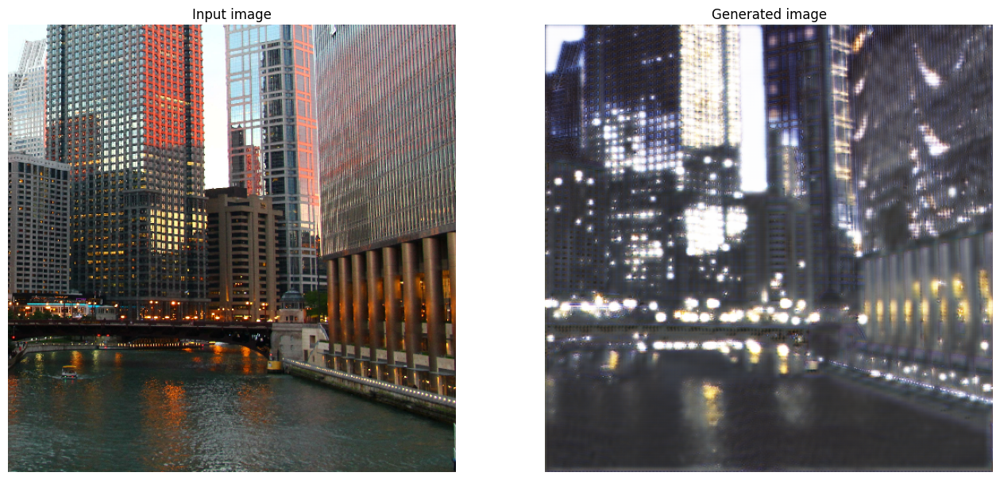

1/1 [==============================] - 0s 72ms/step


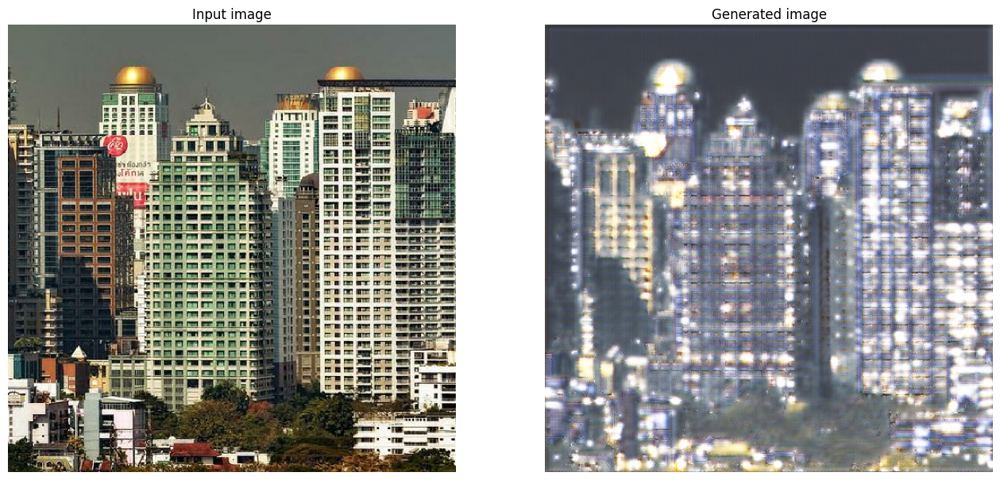

In [32]:
def gen_noise():
  noise=[]
  for i in range(6,10):
    noise.append(tf.random.normal((1,2**i,2**i,1)))
  return noise
noise = gen_noise()
def display_generated_samples(ds, model, n_samples):
    ds_iter = iter(ds)
    noise=gen_noise()

    for n_sample in range(n_samples):
        example_sample = next(ds_iter)
        generated_sample = model.predict(example_sample)

        fig = plt.figure(figsize=(16,8))

        plt.subplot(121)
        plt.title('Input image')
        plt.imshow(example_sample[0] * 0.5 + 0.5)
        plt.axis('off')

        plt.subplot(122)
        plt.title('Generated image')
        plt.imshow(generated_sample[0] * 0.5 + 0.5)
        plt.axis('off')
        plt.show()


display_generated_samples(Day_eval.take(2), day2night_gen, 2)

1/1 [==============================] - 0s 116ms/step


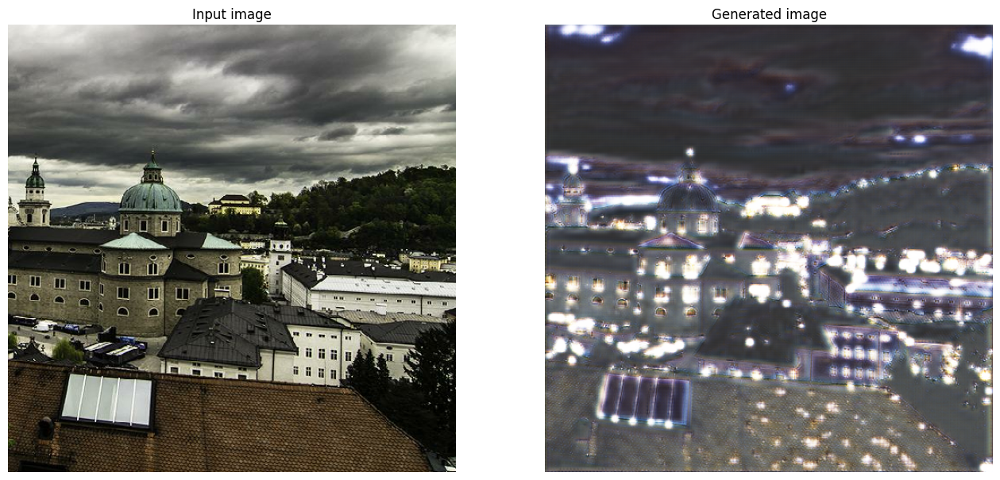

1/1 [==============================] - 0s 70ms/step


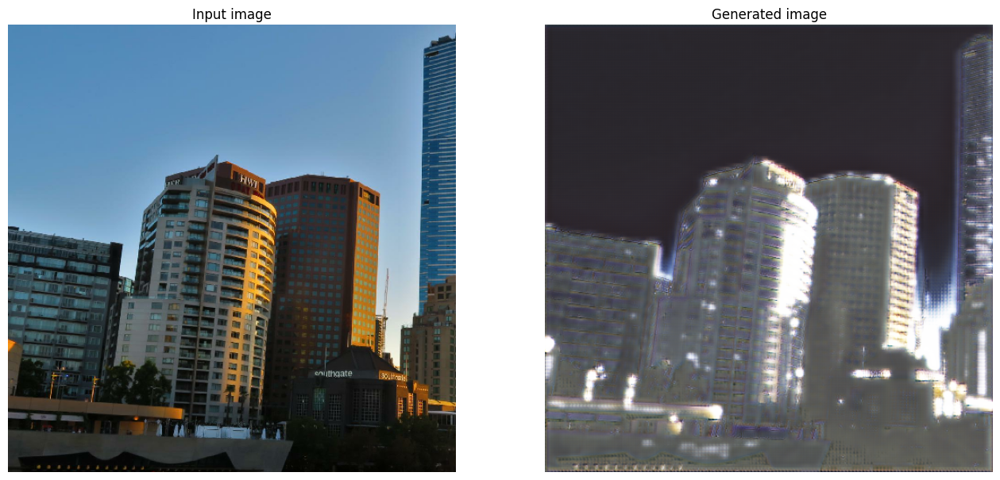

In [33]:
display_generated_samples(Day_eval.take(2), day2night_gen, 2)

1/1 [==============================] - 0s 50ms/step


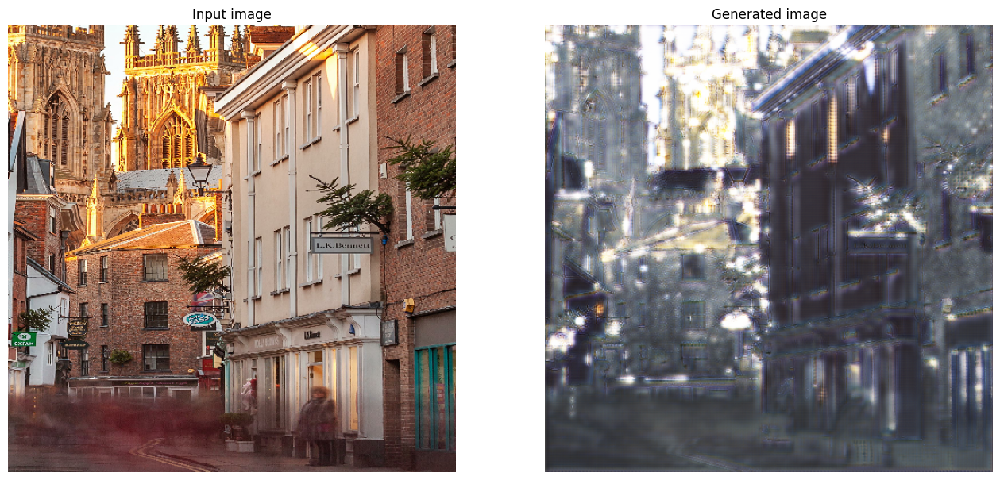

1/1 [==============================] - 0s 53ms/step


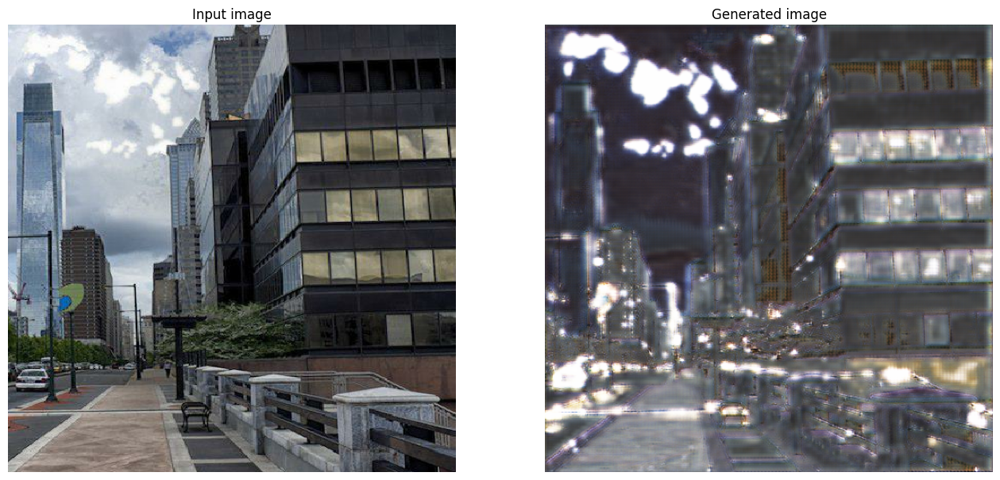

In [34]:
display_generated_samples(Day_eval.take(2), day2night_gen, 2)

<h2 style='color:lightgreen'>Evaluating Night -> Day Generator</h2>


1/1 [==============================] - 2s 2s/step


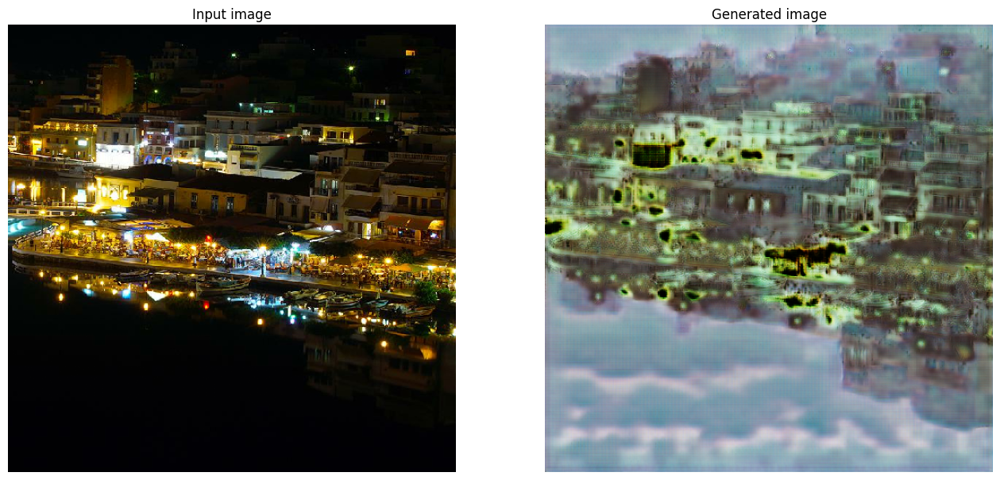

1/1 [==============================] - 0s 112ms/step


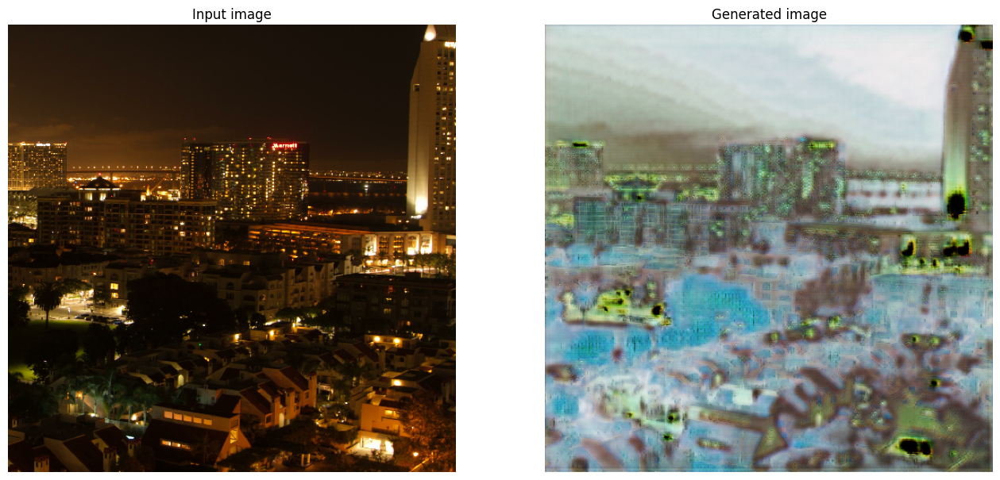

In [35]:
def gen_noise1(batch_size=1):
    noise = []
    noise_shapes = [(64, 64, 1), (128, 128, 1), (256, 256, 1), (512, 512, 1)]
    for shape in noise_shapes:
        noise_input = tf.random.normal([batch_size] + list(shape))
        noise.append(noise_input)
    return noise

def display_generated_N2D_samples(dataset, model, samples):

    ds_iter = iter(dataset)
    noise=gen_noise()
    for n_sample in range(samples):
      example_sample = next(ds_iter)
      batch_size = example_sample.shape[0]  # Get the batch size from the input sample
      style_code = night2day_gen_downmap(tf.convert_to_tensor(example_sample))
      noise = gen_noise1(batch_size=batch_size)  # Generate noise with the correct batch size
      generated_sample = model.predict([example_sample, style_code] + noise)

      fig = plt.figure(figsize=(16,8))

      plt.subplot(121)
      plt.title('Input image')
      plt.imshow(example_sample[0] * 0.5 + 0.5)
      plt.axis('off')

      plt.subplot(122)
      plt.title('Generated image')
      plt.imshow(generated_sample[0] * 0.5 + 0.5)
      plt.axis('off')
      plt.show()


display_generated_N2D_samples(Night_eval.take(2), night2day_gen, 2)

1/1 [==============================] - 0s 77ms/step


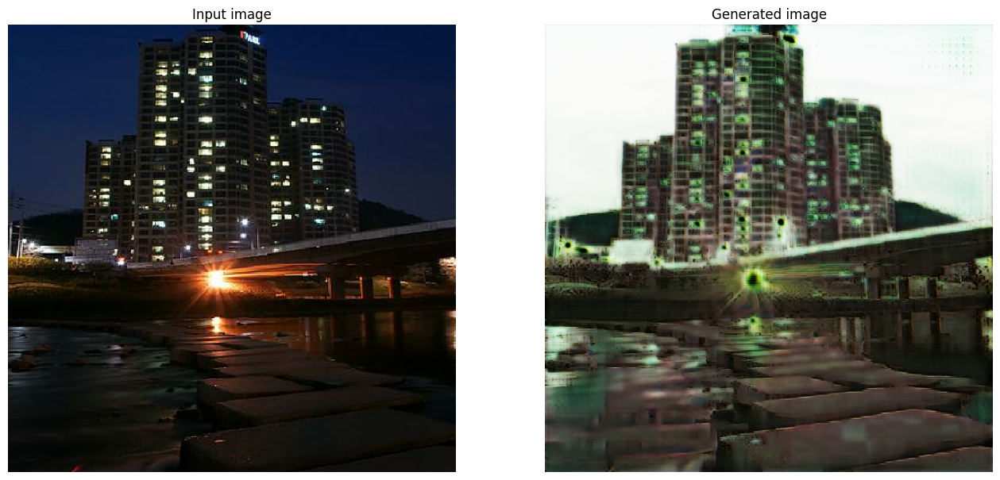

1/1 [==============================] - 0s 79ms/step


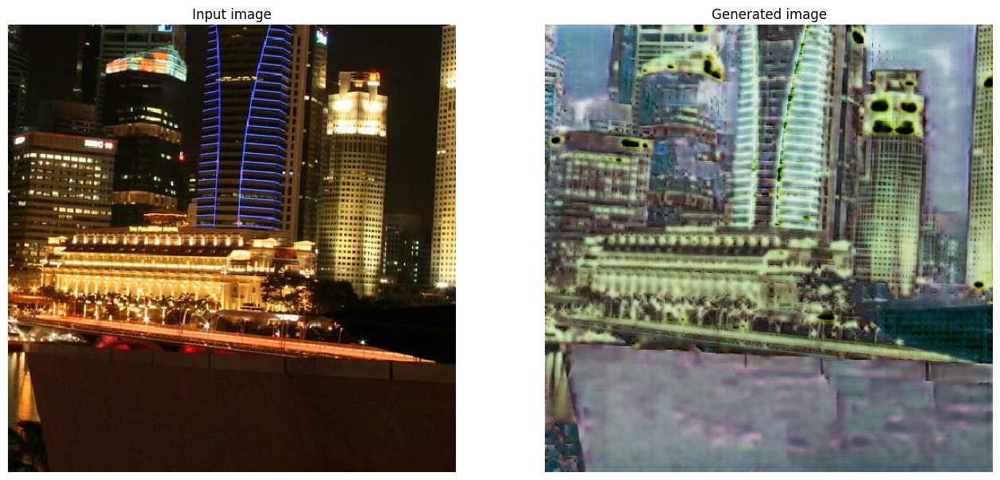

In [36]:

display_generated_N2D_samples(Night_eval.take(2), night2day_gen, 2)

1/1 [==============================] - 0s 50ms/step


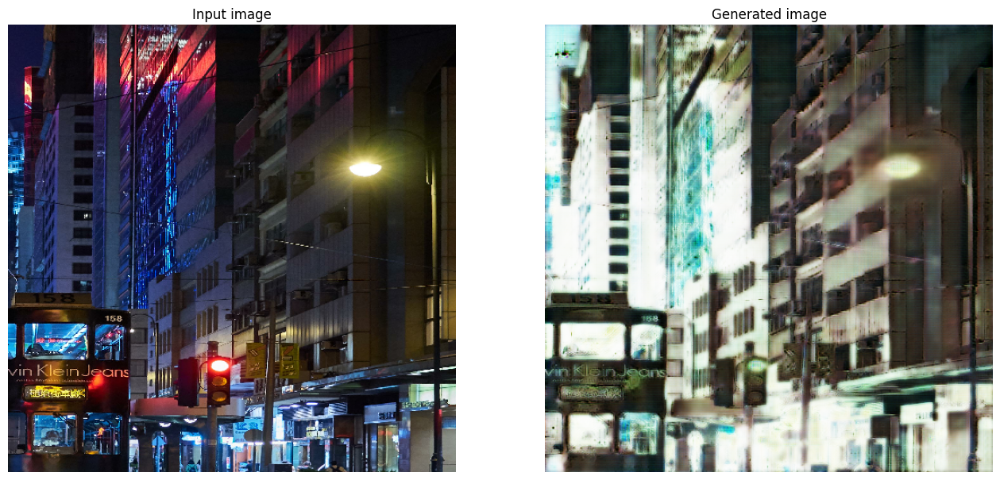

1/1 [==============================] - 0s 75ms/step


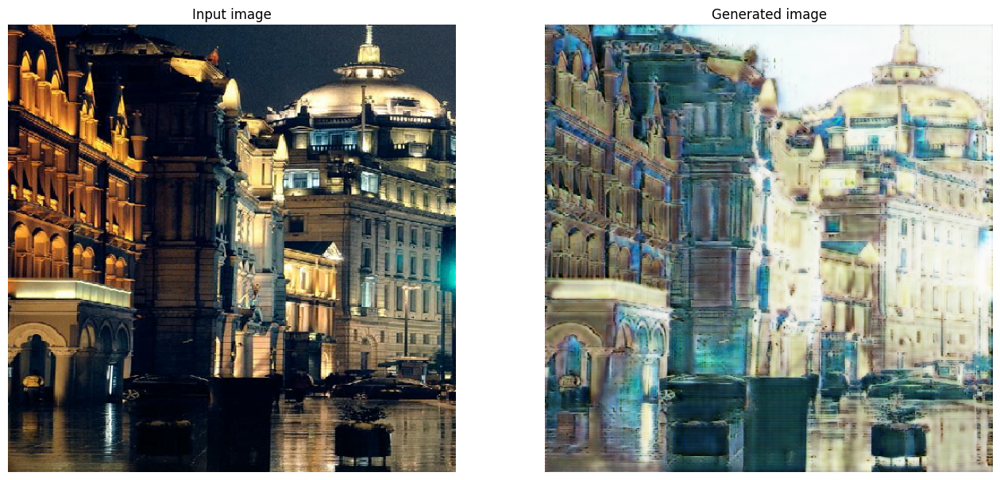

In [37]:

display_generated_N2D_samples(Night_eval.take(2), night2day_gen, 2)

<h2 >References</h2>

[1. https://www.kaggle.com/code/dimitreoliveira/improving-cyclegan-monet-paintings](https://www.kaggle.com/code/dimitreoliveira/improving-cyclegan-monet-paintings)

[2. https://keras.io/examples/generative/stylegan/](https://keras.io/examples/generative/stylegan/)

[3. https://keras.io/examples/generative/wgan_gp/](https://keras.io/examples/generative/wgan_gp/)

[4. https://keras.io/examples/generative/cyclegan/](https://keras.io/examples/generative/cyclegan/)

[5. https://www.kaggle.com/code/virajkadam/day-night-image-translations-using-cyclegan](https://www.kaggle.com/code/virajkadam/day-night-image-translations-using-cyclegan)




